# Using Hugging Face for Computer Vision Tasks

## Image Segmentation

In [2]:
from transformers import pipeline

In [3]:
segmentation = pipeline("image-segmentation", model="nvidia/segformer-b0-finetuned-ade-512-512", device="cuda")

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
Device set to use cuda


In [4]:
segmentation.model.config.id2label

{0: 'wall',
 1: 'building',
 2: 'sky',
 3: 'floor',
 4: 'tree',
 5: 'ceiling',
 6: 'road',
 7: 'bed ',
 8: 'windowpane',
 9: 'grass',
 10: 'cabinet',
 11: 'sidewalk',
 12: 'person',
 13: 'earth',
 14: 'door',
 15: 'table',
 16: 'mountain',
 17: 'plant',
 18: 'curtain',
 19: 'chair',
 20: 'car',
 21: 'water',
 22: 'painting',
 23: 'sofa',
 24: 'shelf',
 25: 'house',
 26: 'sea',
 27: 'mirror',
 28: 'rug',
 29: 'field',
 30: 'armchair',
 31: 'seat',
 32: 'fence',
 33: 'desk',
 34: 'rock',
 35: 'wardrobe',
 36: 'lamp',
 37: 'bathtub',
 38: 'railing',
 39: 'cushion',
 40: 'base',
 41: 'box',
 42: 'column',
 43: 'signboard',
 44: 'chest of drawers',
 45: 'counter',
 46: 'sand',
 47: 'sink',
 48: 'skyscraper',
 49: 'fireplace',
 50: 'refrigerator',
 51: 'grandstand',
 52: 'path',
 53: 'stairs',
 54: 'runway',
 55: 'case',
 56: 'pool table',
 57: 'pillow',
 58: 'screen door',
 59: 'stairway',
 60: 'river',
 61: 'bridge',
 62: 'bookcase',
 63: 'blind',
 64: 'coffee table',
 65: 'toilet',
 66: '

In [5]:
from PIL import Image
import requests

url = 'https://bit.ly/46iDeJQ'
results = segmentation(url)
results

[{'score': None,
  'label': 'wall',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'building',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'sky',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'person',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'airplane',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>}]

wall


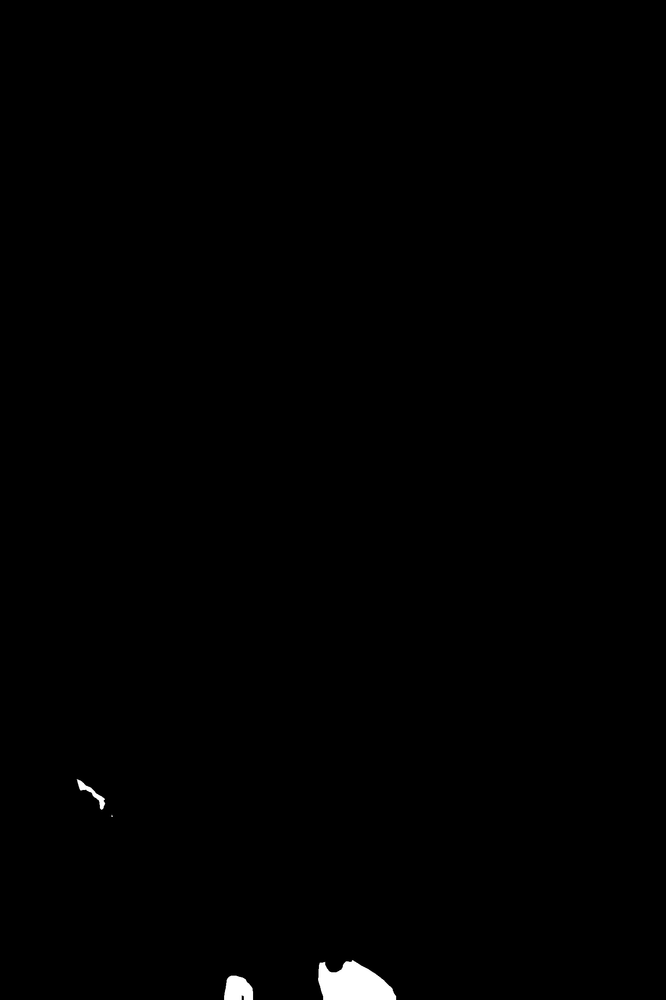

building


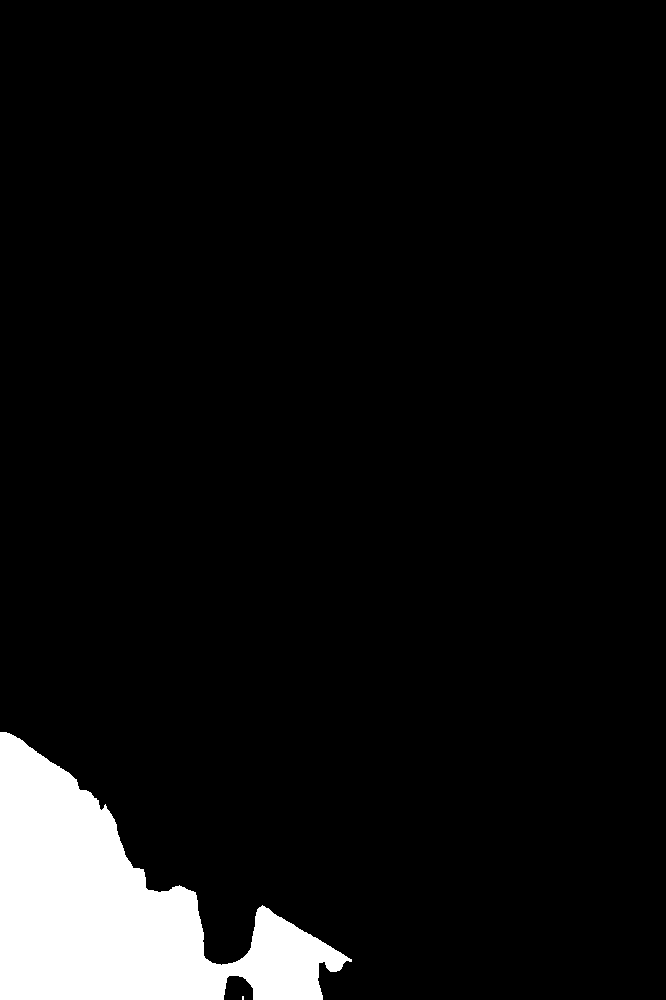

sky


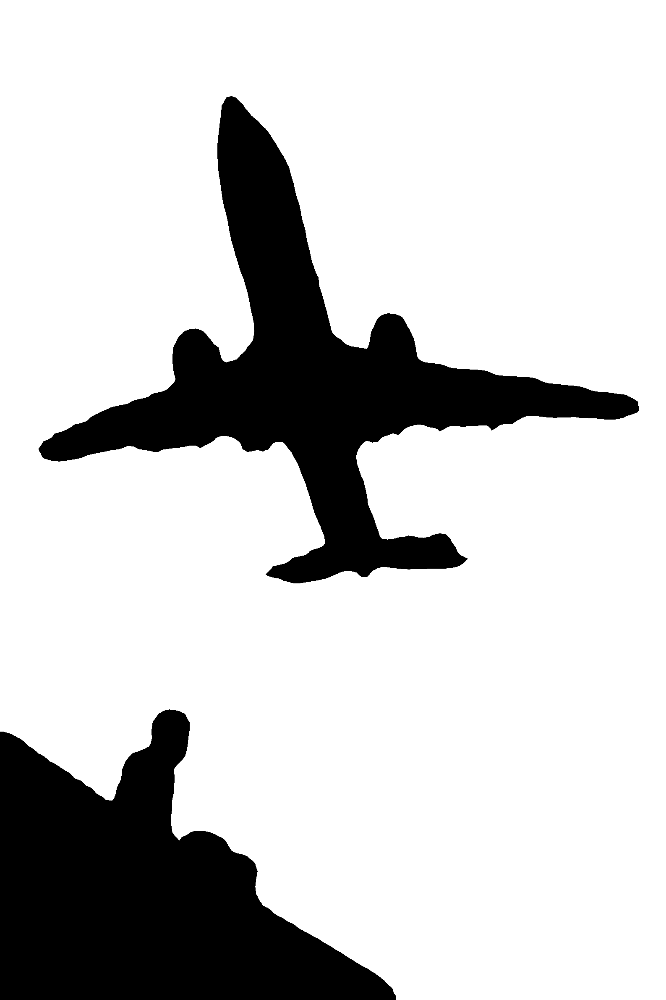

person


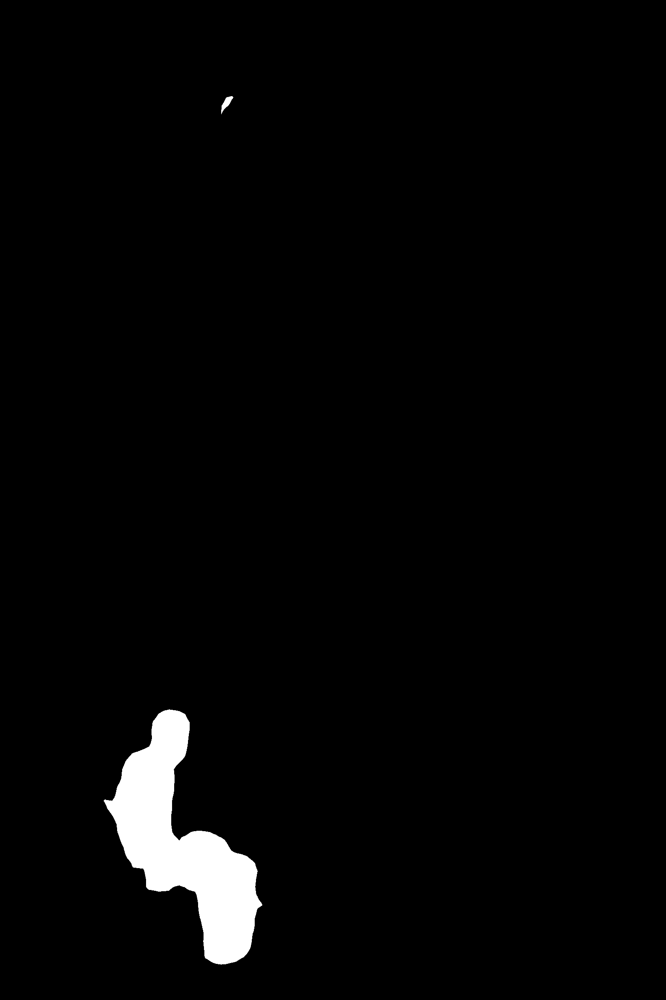

airplane


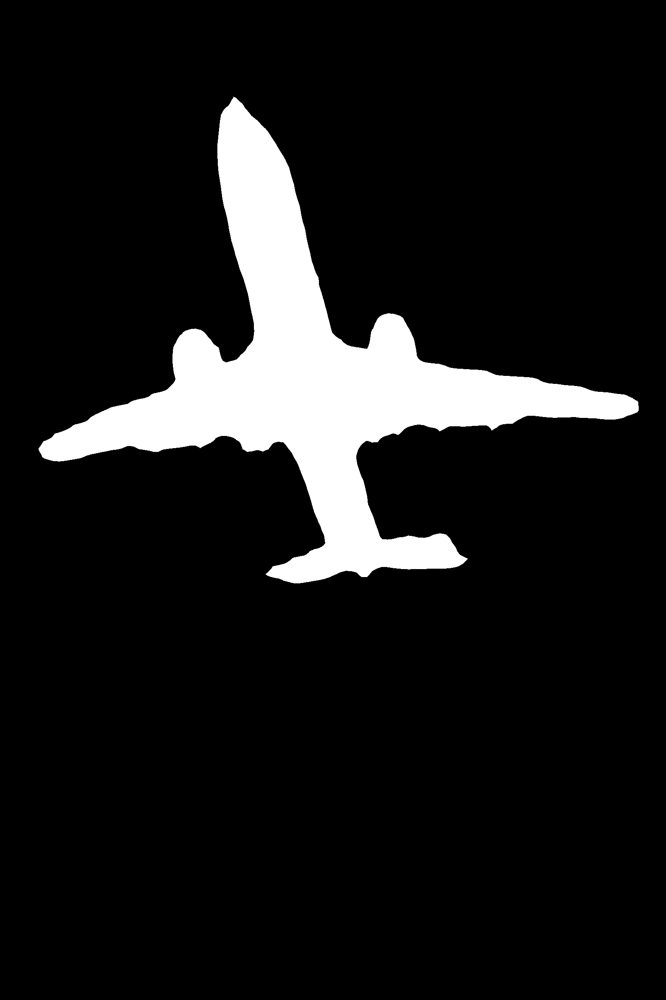

In [6]:
for result in results:
    print(result['label'])
    display(result['mask'])

The white portion of the mask represents the part of the picture containing the segment of interest. You can apply the mask over the original image using the following code snippet:

In [7]:
image = Image.open(requests.get(url, stream=True).raw)

wall


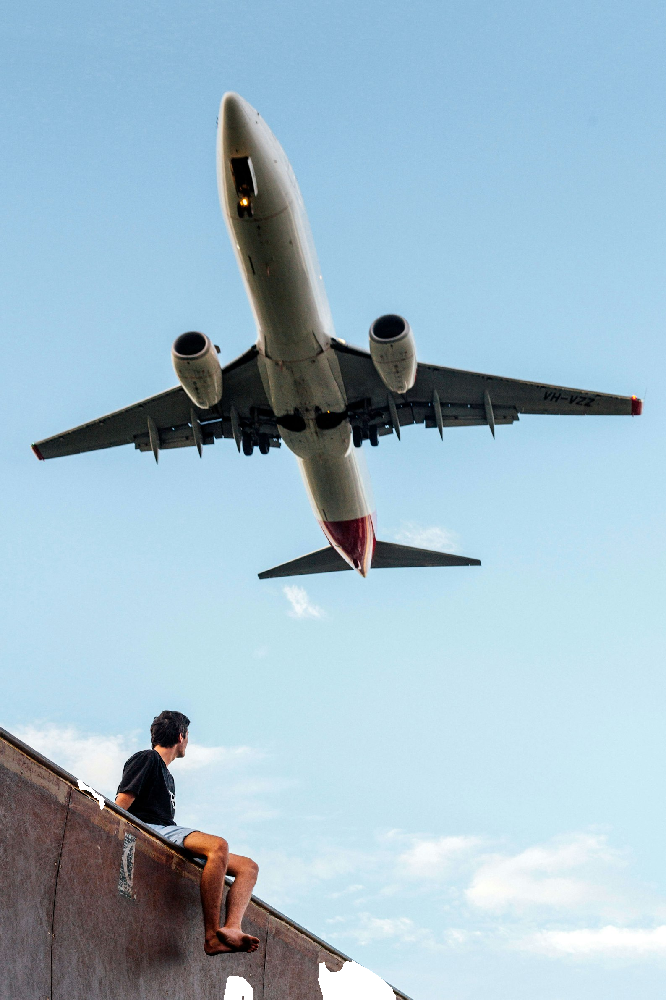

building


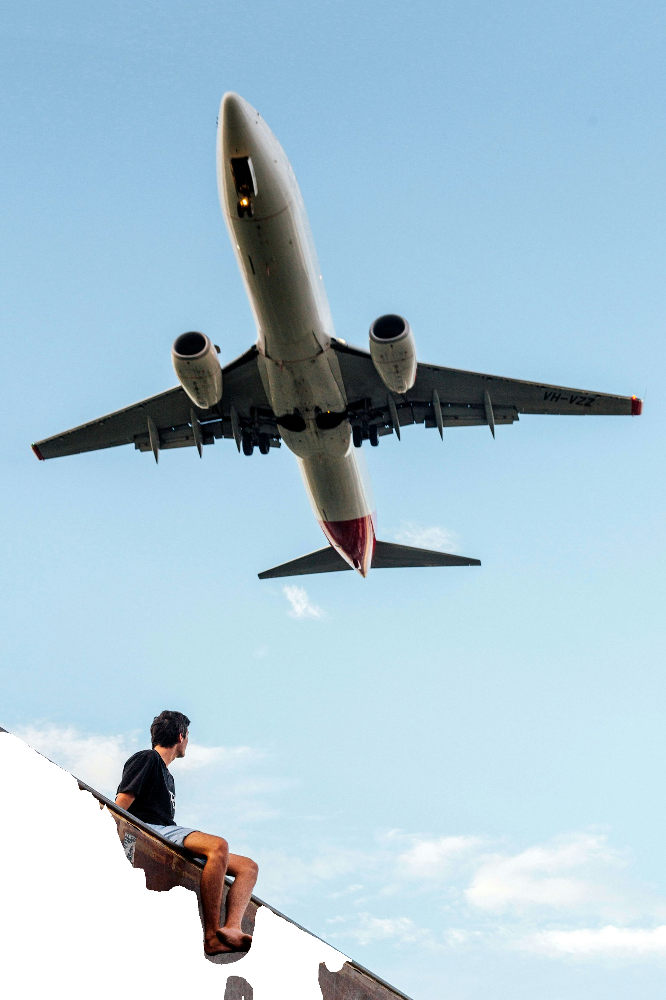

sky


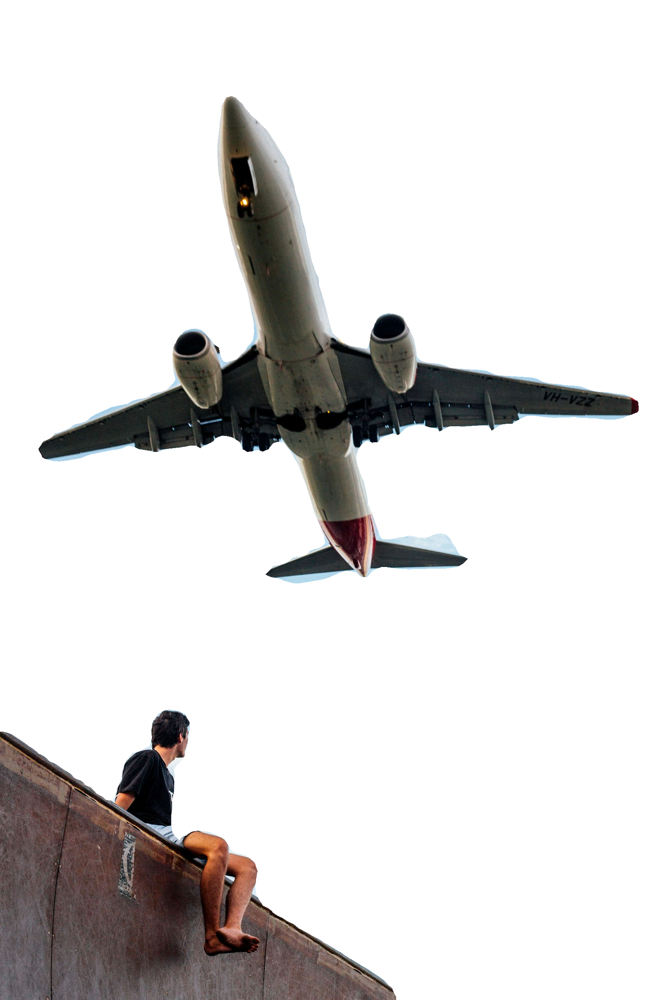

person


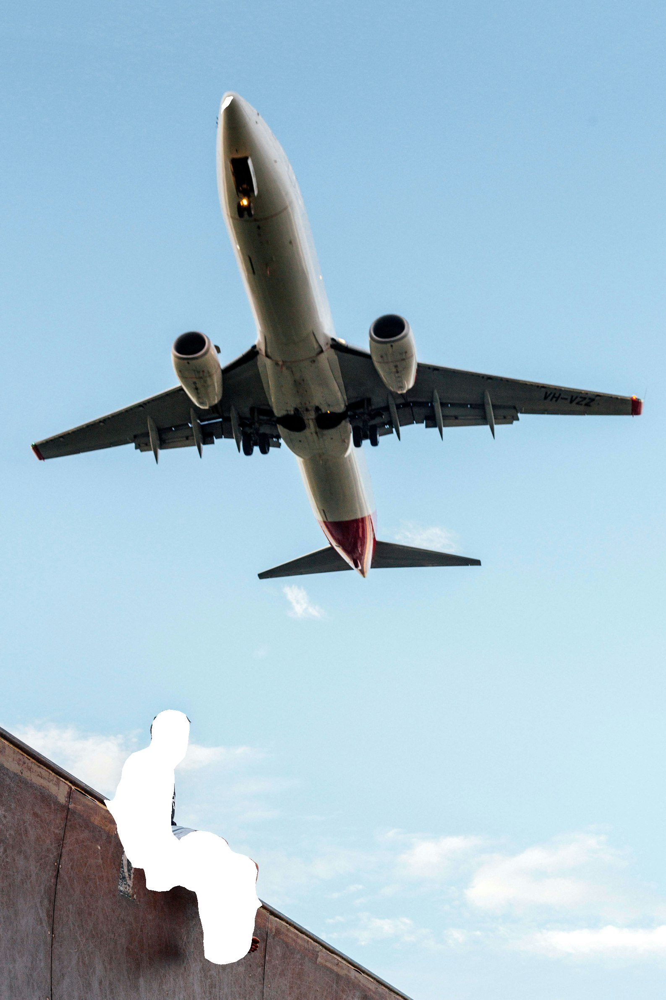

airplane


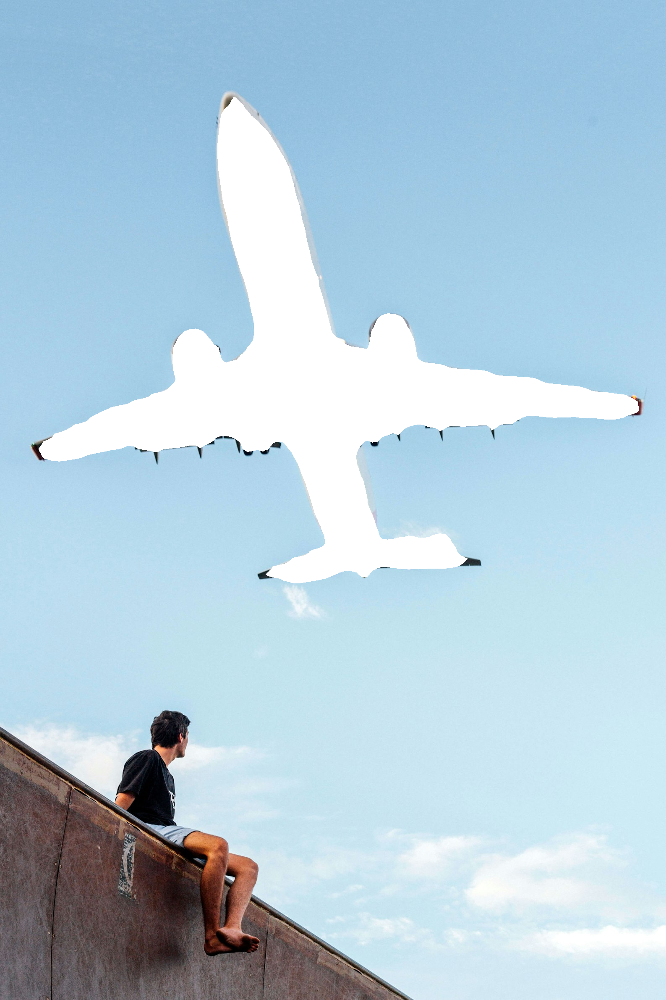

In [8]:
for result in results:
    base_image = image.copy()
    mask_image = result['mask']

    base_image.paste(mask_image, mask=mask_image)
    print(result['label'])
    display(base_image)

When you apply the mask over the image, notice that the segment of interest is in white. It would be more natural to invert this - that is, the segment of interest should be shown, while the rest masked in white

wall


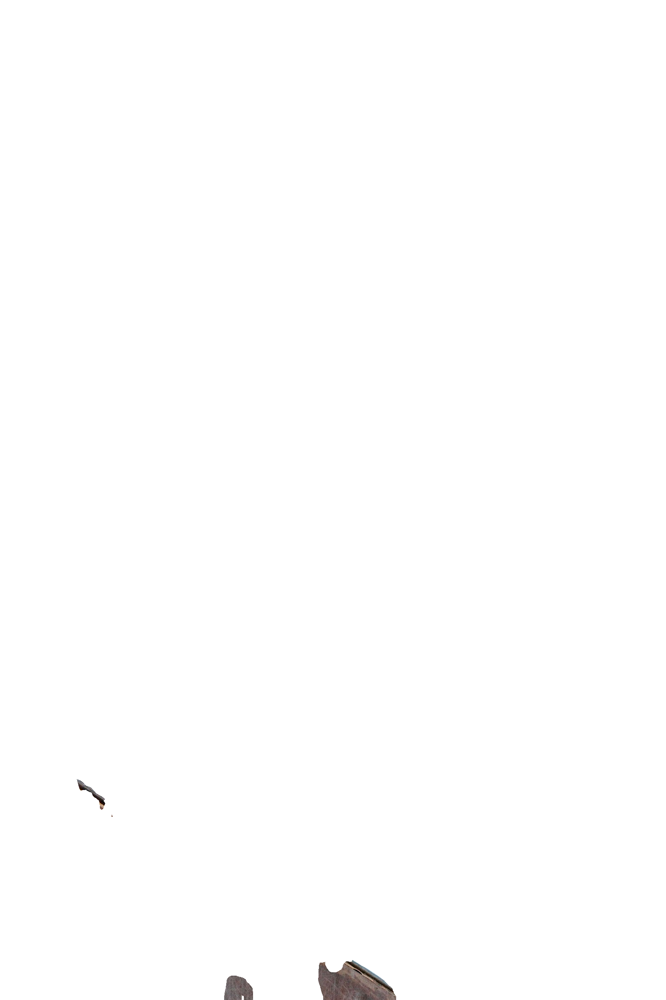

building


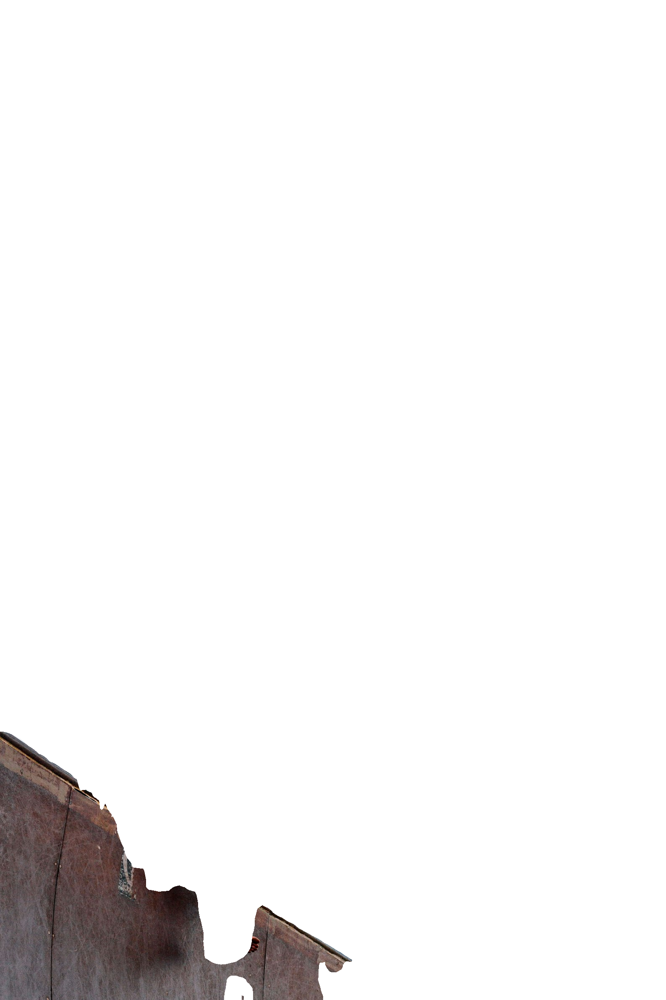

sky


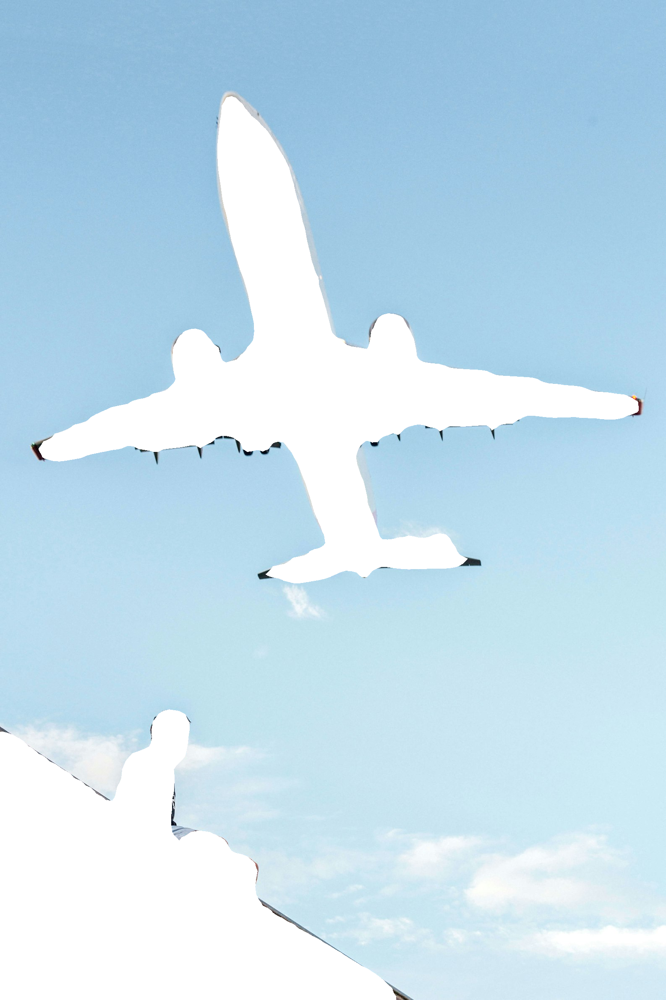

person


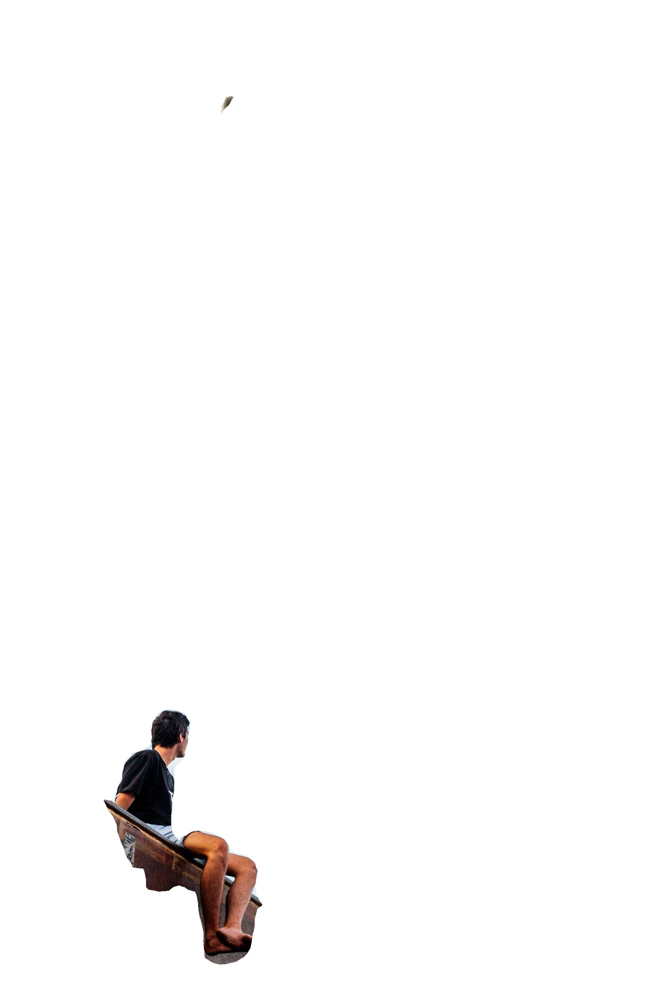

airplane


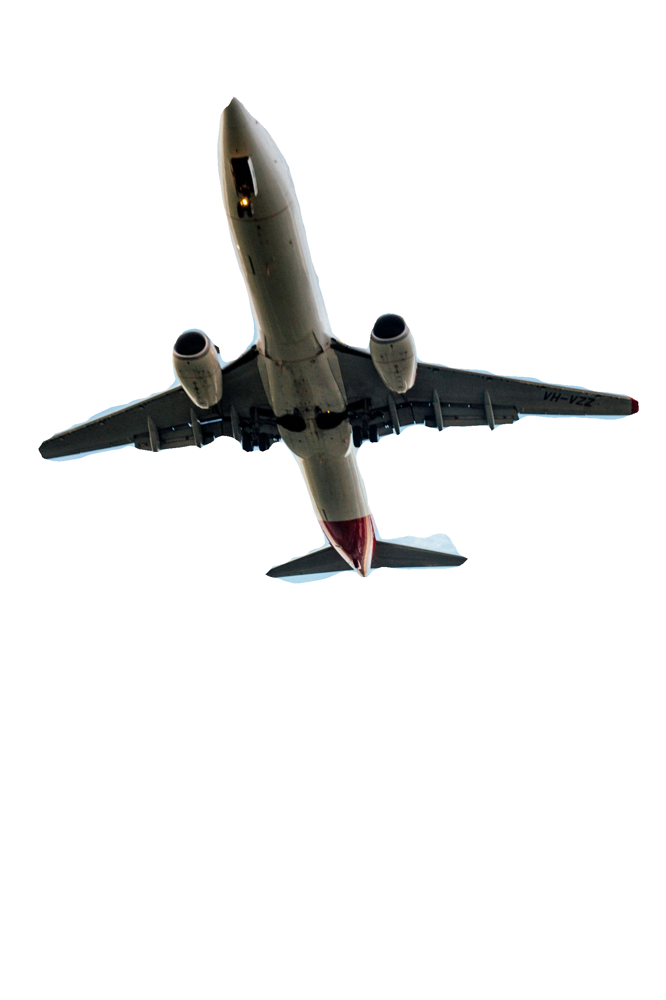

In [9]:
from PIL import ImageOps

for result in results:
    base_image = image.copy()
    mask_image = result['mask']

    mask_image = ImageOps.invert(mask_image)
    base_image.paste(mask_image, mask=mask_image)
    print(result['label'])
    display(base_image)